In [2]:
import warnings
warnings.filterwarnings("ignore")
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import ydata_profiling
%matplotlib inline

# Exploration

In [3]:
data = pd.read_csv("smoking_driking_dataset_Ver01.csv")
df = data.copy()
df

,sex,age,height,weight,waistline,sight_left,sight_right,hear_left,hear_right,SBP,...,LDL_chole,triglyceride,hemoglobin,urine_protein,serum_creatinine,SGOT_AST,SGOT_ALT,gamma_GTP,SMK_stat_type_cd,DRK_YN
0,Male,35,170,75,90.0,1.0,1.0,1.0,1.0,120.0,...,126.0,92.0,17.1,1.0,1.0,21.0,35.0,40.0,1.0,Y
1,Male,30,180,80,89.0,0.9,1.2,1.0,1.0,130.0,...,148.0,121.0,15.8,1.0,0.9,20.0,36.0,27.0,3.0,N
2,Male,40,165,75,91.0,1.2,1.5,1.0,1.0,120.0,...,74.0,104.0,15.8,1.0,0.9,47.0,32.0,68.0,1.0,N
3,Male,50,175,80,91.0,1.5,1.2,1.0,1.0,145.0,...,104.0,106.0,17.6,1.0,1.1,29.0,34.0,18.0,1.0,N
4,Male,50,165,60,80.0,1.0,1.2,1.0,1.0,138.0,...,117.0,104.0,13.8,1.0,0.8,19.0,12.0,25.0,1.0,N
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
991341,Male,45,175,80,92.1,1.5,1.5,1.0,1.0,114.0,...,125.0,132.0,15.0,1.0,1.0,26.0,36.0,27.0,1.0,N
991342,Male,35,170,75,86.0,1.0,1.5,1.0,1.0,119.0,...,84.0,45.0,15.8,1.0,1.1,14.0,17.0,15.0,1.0,N
991343,Female,40,155,50,68.0,1.0,0.7,1.0,1.0,110.0,...,77.0,157.0,14.3,1.0,0.8,30.0,27.0,17.0,3.0,Y
991344,Male,25,175,60,72.0,1.5,1.0,1.0,1.0,119.0,...,73.0,53.0,14.5,1.0,0.8,21.0,14.0,17.0,1.0,N


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 991346 entries, 0 to 991345
Data columns (total 24 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   sex               991346 non-null  object 
 1   age               991346 non-null  int64  
 2   height            991346 non-null  int64  
 3   weight            991346 non-null  int64  
 4   waistline         991346 non-null  float64
 5   sight_left        991346 non-null  float64
 6   sight_right       991346 non-null  float64
 7   hear_left         991346 non-null  float64
 8   hear_right        991346 non-null  float64
 9   SBP               991346 non-null  float64
 10  DBP               991346 non-null  float64
 11  BLDS              991346 non-null  float64
 12  tot_chole         991346 non-null  float64
 13  HDL_chole         991346 non-null  float64
 14  LDL_chole         991346 non-null  float64
 15  triglyceride      991346 non-null  float64
 16  hemoglobin        99

In [19]:
ydata_profiling.ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [21]:
# export the report to html file

# profile = ydata_profiling.ProfileReport(df)
# profile.to_file(output_file="smoking_drinking_report.html")

# nevermind, no way to include the report in the repo in a viewable way.

In [5]:
df_with_duplicates = df.shape[0]
df = df.drop_duplicates()
df_without_duplicates = df.shape[0]
print(f"Dropped a total of {df_with_duplicates-df_without_duplicates} entries.")

Dropped a total of 26 entries.


# Outliers

Variables that I can see have outliers and/or are skewed based on distributions (as seen in the YData Report) that I think will be a problem: waistline, HDL_chole, LDL_chole, sight_left, sight_right, SBP, and triglyceride. 

hear_left, hear_right are imbalanced.

Parametric models are sensitive to outliers and skewed data. XGBoost and KNN will not be incredibly sensitive to outliers, but will be sensitive to skewed data.

## Z-Score Method for Outlier Detection

In [6]:
df_before_outlierD = df.shape[0]

numeric_cols = [
    "age",
    "height",
    "weight",
    "waistline",
    "sight_left",
    "sight_right",
    "SBP",
    "DBP",
    "BLDS",
    "tot_chole",
    "HDL_chole",
    "LDL_chole",
    "triglyceride",
    "hemoglobin",
    "serum_creatinine",
    "SGOT_AST",
    "SGOT_ALT",
    "gamma_GTP",
]

z_scores = (
    df[numeric_cols] - df[numeric_cols].mean()
) / df[numeric_cols].std()

# 3 Standard deviations
threshold = 3
outliers = np.abs(z_scores) > threshold
outlier_columns = outliers.columns[outliers.any()]
df_cleaned = df[~outliers.any(axis=1)]

df_after_outlierD = df_cleaned.shape[0]

print(
    f"Removal of outliers reduced instances from {df_before_outlierD} to {df_after_outlierD} by {df_before_outlierD-df_after_outlierD} entries."
)

Removal of outliers reduced instances from 991320 to 904029 by 87291 entries.


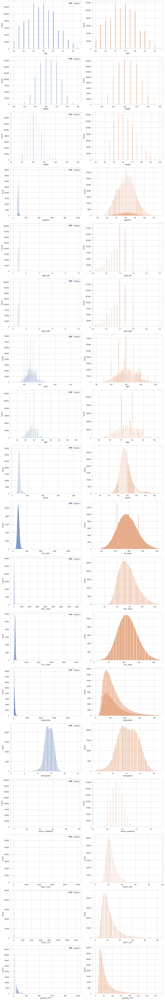

In [48]:
num_rows = len(numeric_cols)
num_cols = 2

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))

sns.set(style="whitegrid")

for i, column in enumerate(numeric_cols):
    sns.histplot(data=df, x=column, ax=axes[i, 0], label="Original")
    axes[i, 0].set_xlabel(column)
    axes[i, 0].set_ylabel("Count")

    sns.histplot(
        data=df_cleaned,
        x=column,
        ax=axes[i, 1],
        label="Cleaned",
        color=sns.color_palette()[1],
    )
    axes[i, 1].set_xlabel(column)
    axes[i, 1].set_ylabel("Count")

for ax in axes[:, 0]:
    ax.legend(loc="upper right")

for i in range(num_rows):
    for j in range(2, num_cols):
        fig.delaxes(axes[i, j])

plt.tight_layout()
plt.show()

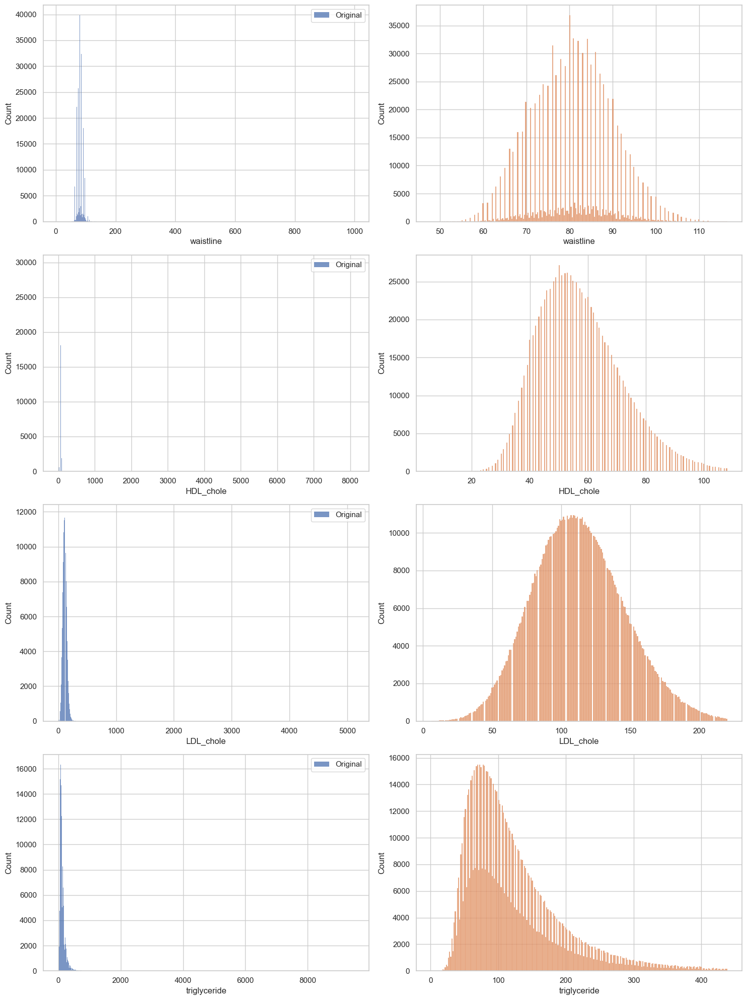

In [46]:
#Plot to include in blog post
cols_to_plot = ["waistline", "HDL_chole", "LDL_chole", "triglyceride"]

num_rows = len(cols_to_plot)
num_cols = 2

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))

sns.set(style="whitegrid")

for i, column in enumerate(cols_to_plot):
    sns.histplot(data=df, x=column, ax=axes[i, 0], label="Original")
    axes[i, 0].set_xlabel(column)
    axes[i, 0].set_ylabel("Count")

    sns.histplot(
        data=df_cleaned,
        x=column,
        ax=axes[i, 1],
        label="Cleaned",
        color=sns.color_palette()[1],
    )
    axes[i, 1].set_xlabel(column)
    axes[i, 1].set_ylabel("Count")

for ax in axes[:, 0]:
    ax.legend(loc="upper right")

for i in range(num_rows):
    for j in range(2, num_cols):
        fig.delaxes(axes[i, j])

plt.tight_layout()
# plt.savefig("outlier_removal.png")
plt.show()

## PCA

In [ ]:
pca_90 = PCA(n_components=0.9)
pca_90.fit(X_train)
n_components_90 = pca_90.n_components_
print("Number of components to capture 90% variance:", n_components_90)

# Preliminary Data Analysis for Baseline Models

In [96]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.metrics import classification_report, accuracy_score
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, OneHotEncoder, OrdinalEncoder

In [88]:
X = df_cleaned.drop('DRK_YN', axis=1)
y = df_cleaned['DRK_YN'].map({'Y': 1, 'N': 0})

X_subset = X.iloc[:10500]
y_subset = y.iloc[:10500]

X_train, X_test = X_subset[:10000], X_subset[10000:]
y_train, y_test = y_subset[:10000], y_subset[10000:]

ordinal_cols = [
    "hear_left", 
    "hear_right", 
    "urine_protein", 
    "SMK_stat_type_cd",
    ]

nominal_cols = [
    "sex",
    "SMK_stat_type_cd",
    ]

numeric_cols = [
    "age",
    "height",
    "weight",
    "waistline",
    "sight_left",
    "sight_right",
    "SBP",
    "DBP",
    "BLDS",
    "tot_chole",
    "HDL_chole",
    "LDL_chole",
    "triglyceride",
    "hemoglobin",
    "serum_creatinine",
    "SGOT_AST",
    "SGOT_ALT",
    "gamma_GTP",
]

In [89]:
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])

ordinal_transformer = Pipeline(steps=[
    ('ordinal', OrdinalEncoder())
])

nominal_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_cols),
        ('ord', ordinal_transformer, ordinal_cols),
        ('nom', nominal_transformer, nominal_cols)
    ])

In [90]:
# train logistic regression model

lr_pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('classifier', LogisticRegression())
])

lr_pipeline.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   StandardScaler())]),
                                                  ['age', 'height', 'weight',
                                                   'waistline', 'sight_left',
                                                   'sight_right', 'SBP', 'DBP',
                                                   'BLDS', 'tot_chole',
                                                   'HDL_chole', 'LDL_chole',
                                                   'triglyceride', 'hemoglobin',
                                                   'serum_creatinine',
                                                   'SGOT_AST', 'SGOT_ALT',
                                                   'gamma_GTP']),
                                                 ('ord',
                                                  Pipeline(steps=[('ordinal',
                                                                   OrdinalEncoder())]),
                                                  ['hear_left', 'hear_right',
                                                   'urine_protein',
                                                   'SMK_stat_type_cd']),
                                                 ('nom',
                                                  Pipeline(steps=[('onehot',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['sex',
                                                   'SMK_stat_type_cd'])])),
                ('classifier', LogisticRegression())])

In [91]:
# train SVM model

svm_pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('classifier', SVC())
])

svm_pipeline.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   StandardScaler())]),
                                                  ['age', 'height', 'weight',
                                                   'waistline', 'sight_left',
                                                   'sight_right', 'SBP', 'DBP',
                                                   'BLDS', 'tot_chole',
                                                   'HDL_chole', 'LDL_chole',
                                                   'triglyceride', 'hemoglobin',
                                                   'serum_creatinine',
                                                   'SGOT_AST', 'SGOT_ALT',
                                                   'gamma_GTP']),
                                                 ('ord',
                                                  Pipeline(steps=[('ordinal',
                                                                   OrdinalEncoder())]),
                                                  ['hear_left', 'hear_right',
                                                   'urine_protein',
                                                   'SMK_stat_type_cd']),
                                                 ('nom',
                                                  Pipeline(steps=[('onehot',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['sex',
                                                   'SMK_stat_type_cd'])])),
                ('classifier', SVC())])

In [93]:
# Test and eval logistic regression
lr_predictions = lr_pipeline.predict(X_test)
print(f"Logistic Regression Accuracy Score: {accuracy_score(y_test, lr_predictions)}")
print("Logistic Regression Classification Report:")
print(classification_report(y_test, lr_predictions))

# Test and eval SVM
svm_predictions = svm_pipeline.predict(X_test)
print(f"SVM Accuracy Score: {accuracy_score(y_test, svm_predictions)}")
print("SVM Classification Report:")
print(classification_report(y_test, svm_predictions))

Logistic Regression Accuracy Score: 0.702
Logistic Regression Classification Report:
              precision    recall  f1-score   support

           0       0.71      0.75      0.73       271
           1       0.69      0.64      0.66       229

    accuracy                           0.70       500
   macro avg       0.70      0.70      0.70       500
weighted avg       0.70      0.70      0.70       500

SVM Accuracy Score: 0.712
SVM Classification Report:
              precision    recall  f1-score   support

           0       0.73      0.75      0.74       271
           1       0.69      0.66      0.68       229

    accuracy                           0.71       500
   macro avg       0.71      0.71      0.71       500
weighted avg       0.71      0.71      0.71       500



## PCA

In [94]:
from sklearn.decomposition import PCA

In [95]:
X = df_cleaned.drop('DRK_YN', axis=1)

numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])

ordinal_transformer = Pipeline(steps=[
    ('ordinal', OrdinalEncoder())
])

nominal_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_cols),
        ('ord', ordinal_transformer, ordinal_cols),
        ('nom', nominal_transformer, nominal_cols)
    ])

X_processed = preprocessor.fit_transform(X)

In [98]:
# Initialize PCA
pca = PCA(n_components=0.9)

# Apply PCA to the preprocessed data
X_pca = pca.fit_transform(X_processed)

print(f"Number of components for 90% of variability: {pca.n_components_}")

Number of components for 90% of variability: 13


## Baseline Models with PCA as Input

In [99]:
X = df_cleaned.drop('DRK_YN', axis=1)
y = df_cleaned['DRK_YN'].map({'Y': 1, 'N': 0})

X_train = X.iloc[:10000]
y_train = y.iloc[:10000]
X_test = X.iloc[10000:10500]
y_test = y.iloc[10000:10500]

In [100]:
pca_numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])

pca_ordinal_transformer = Pipeline(steps=[
    ('ordinal', OrdinalEncoder())
])

pca_nominal_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

pca_preprocessor = ColumnTransformer(
    transformers=[
        ('num', pca_numeric_transformer, numeric_cols),
        ('ord', pca_ordinal_transformer, ordinal_cols),
        ('nom', pca_nominal_transformer, nominal_cols)
    ])

pca = PCA(n_components=13)

In [101]:
# logistic regression with PCA

pca_lr_pipeline = Pipeline(steps=[
    ('preprocessor', pca_preprocessor),
    ('pca', pca),
    ('classifier', LogisticRegression())
])

pca_lr_pipeline.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   StandardScaler())]),
                                                  ['age', 'height', 'weight',
                                                   'waistline', 'sight_left',
                                                   'sight_right', 'SBP', 'DBP',
                                                   'BLDS', 'tot_chole',
                                                   'HDL_chole', 'LDL_chole',
                                                   'triglyceride', 'hemoglobin',
                                                   'serum_creatinine',
                                                   'SGOT_AST', 'SGOT_ALT',
                                                   'gamma_GTP']),
                                                 ('ord',
                                                  Pipeline(steps=[('ordinal',
                                                                   OrdinalEncoder())]),
                                                  ['hear_left', 'hear_right',
                                                   'urine_protein',
                                                   'SMK_stat_type_cd']),
                                                 ('nom',
                                                  Pipeline(steps=[('onehot',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['sex',
                                                   'SMK_stat_type_cd'])])),
                ('pca', PCA(n_components=13)),
                ('classifier', LogisticRegression())])

In [102]:
# SVM with PCA

pca_svm_pipeline = Pipeline(steps=[
    ('preprocessor', pca_preprocessor),
    ('pca', pca),
    ('classifier', SVC())
])

pca_svm_pipeline.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   StandardScaler())]),
                                                  ['age', 'height', 'weight',
                                                   'waistline', 'sight_left',
                                                   'sight_right', 'SBP', 'DBP',
                                                   'BLDS', 'tot_chole',
                                                   'HDL_chole', 'LDL_chole',
                                                   'triglyceride', 'hemoglobin',
                                                   'serum_creatinine',
                                                   'SGOT_AST', 'SGOT_ALT',
                                                   'gamma_GTP']),
                                                 ('ord',
                                                  Pipeline(steps=[('ordinal',
                                                                   OrdinalEncoder())]),
                                                  ['hear_left', 'hear_right',
                                                   'urine_protein',
                                                   'SMK_stat_type_cd']),
                                                 ('nom',
                                                  Pipeline(steps=[('onehot',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['sex',
                                                   'SMK_stat_type_cd'])])),
                ('pca', PCA(n_components=13)), ('classifier', SVC())])

In [103]:
# Test and eval logistic regression with PCA
pca_lr_predictions = pca_lr_pipeline.predict(X_test)
print(f"Logistic Regression Accuracy Score: {accuracy_score(y_test, pca_lr_predictions)}")
print("Logistic Regression Classification Report:")
print(classification_report(y_test, pca_lr_predictions))

# Test and eval SVM with PCA
pca_svm_predictions = pca_svm_pipeline.predict(X_test)
print(f"SVM Accuracy Score: {accuracy_score(y_test, pca_svm_predictions)}")
print("SVM Classification Report:")
print(classification_report(y_test, pca_svm_predictions))

Logistic Regression Accuracy Score: 0.678
Logistic Regression Classification Report:
              precision    recall  f1-score   support

           0       0.69      0.73      0.71       271
           1       0.66      0.62      0.64       229

    accuracy                           0.68       500
   macro avg       0.68      0.67      0.67       500
weighted avg       0.68      0.68      0.68       500

SVM Accuracy Score: 0.714
SVM Classification Report:
              precision    recall  f1-score   support

           0       0.73      0.76      0.74       271
           1       0.70      0.66      0.68       229

    accuracy                           0.71       500
   macro avg       0.71      0.71      0.71       500
weighted avg       0.71      0.71      0.71       500



# Save smaller dataset for hyperparameter tuning

In [62]:
#randomly remove 80% of the data
df_new = df_cleaned.sample(frac=0.2, random_state=1)
df_new

,sex,age,height,weight,waistline,sight_left,sight_right,hear_left,hear_right,SBP,...,LDL_chole,triglyceride,hemoglobin,urine_protein,serum_creatinine,SGOT_AST,SGOT_ALT,gamma_GTP,SMK_stat_type_cd,DRK_YN
517503,Female,25,165,65,73.1,0.9,0.9,1.0,1.0,120.0,...,80.0,42.0,15.3,1.0,1.0,16.0,9.0,13.0,2.0,Y
427253,Male,65,165,60,83.0,0.9,1.0,1.0,1.0,160.0,...,91.0,173.0,13.0,1.0,1.3,28.0,12.0,37.0,2.0,N
516410,Male,50,175,70,78.0,0.5,0.6,1.0,1.0,108.0,...,80.0,25.0,15.6,1.0,1.0,23.0,17.0,15.0,1.0,Y
386581,Male,55,160,65,79.0,1.5,1.5,1.0,1.0,128.0,...,119.0,92.0,17.7,1.0,1.0,40.0,43.0,74.0,3.0,Y
380612,Female,20,155,55,72.8,1.5,0.7,1.0,1.0,119.0,...,66.0,87.0,13.2,1.0,0.7,14.0,8.0,18.0,1.0,Y
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
499381,Female,60,155,70,81.0,0.9,1.8,1.0,1.0,145.0,...,82.0,88.0,12.4,1.0,1.0,41.0,39.0,15.0,1.0,N
727520,Male,30,175,70,75.0,0.7,0.8,1.0,1.0,106.0,...,105.0,55.0,14.8,1.0,1.1,19.0,29.0,45.0,2.0,Y
709850,Male,25,175,75,98.0,1.0,1.0,1.0,1.0,118.0,...,132.0,171.0,16.1,1.0,0.9,38.0,58.0,51.0,3.0,N
932769,Female,60,150,55,84.0,0.4,0.8,1.0,1.0,130.0,...,111.0,221.0,16.3,3.0,0.8,58.0,60.0,29.0,1.0,N


In [104]:
df_new.to_csv("smoking_drinking_hyperparams.csv", index=False)

# Save cleaned dataset for training

In [105]:
df_cleaned.to_csv("smoking_drinking_train.csv", index=False)